In [1]:
import pandas as pd
import numpy as np
from autoviz.AutoViz_Class import AutoViz_Class
import featurewiz as FW
from autoviml.Auto_ViML import Auto_ViML
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import precision_score, recall_score, f1_score
import warnings, os

Alert! from version 0.1.43, after importing, you must do '%matplotlib inline' to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


Imported 0.1.99 version. Select nrows to a small number when running on huge datasets.
output = featurewiz(dataname, target, corr_limit=0.70, verbose=2, sep=',', 
		header=0, test_data='',feature_engg='', category_encoders='',
		dask_xgboost_flag=False, nrows=None)
Create new features via 'feature_engg' flag : ['interactions','groupby','target']

Imported Auto_ViML version: 0.1.710. Call using:
             m, feats, trainm, testm = Auto_ViML(train, target, test,
                            sample_submission='',
                            scoring_parameter='', KMeans_Featurizer=False,
                            hyper_param='RS',feature_reduction=True,
                             Boosting_Flag='CatBoost', Binning_Flag=False,
                            Add_Poly=0, Stacking_Flag=False,Imbalanced_Flag=False,
                            verbose=1)
            

Imported Auto_NLP version: 0.1.01.. Call using:
     train_nlp, test_nlp, nlp_pipeline, predictions = Auto_NLP(
               

In [2]:
# change directory so that the automatically generated datasets are saved in root
if os.getcwd()[-4:] == "code":
    os.chdir("../")

In [3]:
# read in oringinal raw data
df_client = pd.read_csv("./data/raw/df_client.csv")

In [7]:
# Initiate AutoViz_Class for data visualization
AV = AutoViz_Class()

Shape of your Data Set loaded: (28224, 124)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    Number of Numeric Columns =  118
    Number of Integer-Categorical Columns =  3
    Number of String-Categorical Columns =  1
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  1
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    123 Predictors classified...
        No variables removed since no ID or low-information variables found in data set

################ Multi_Classification problem #####################
Number of variables

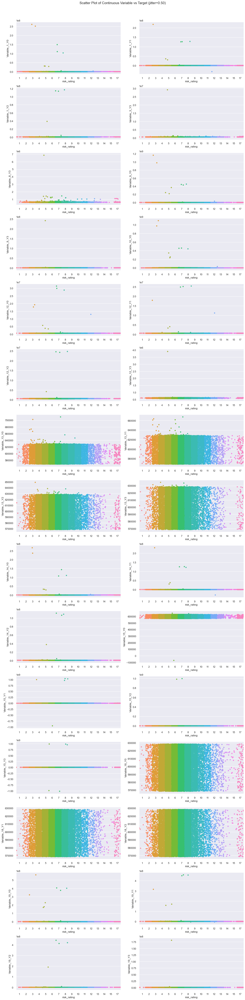

Total Number of Scatter Plots = 465


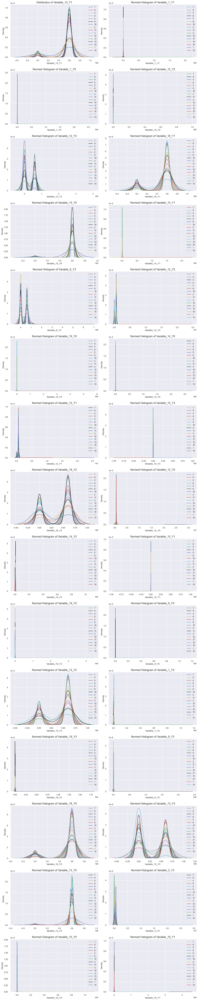

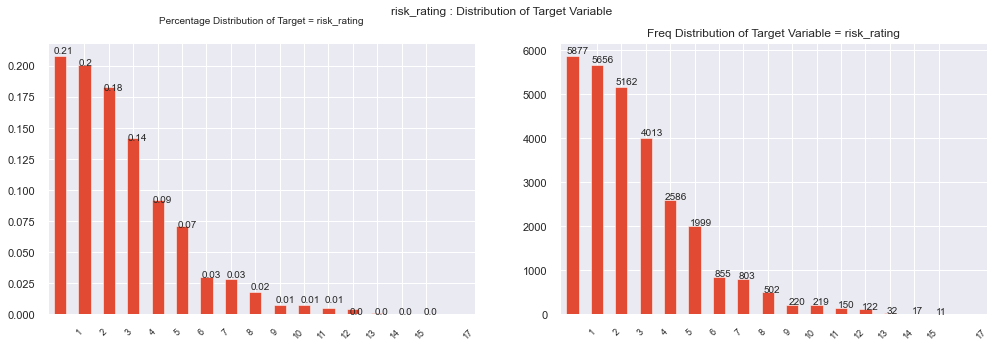

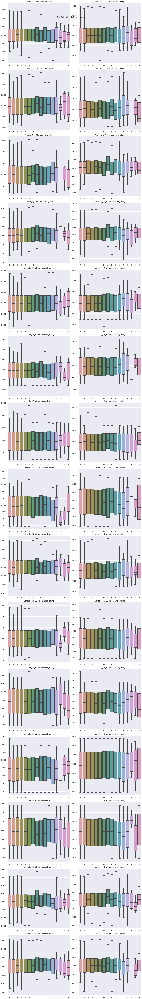

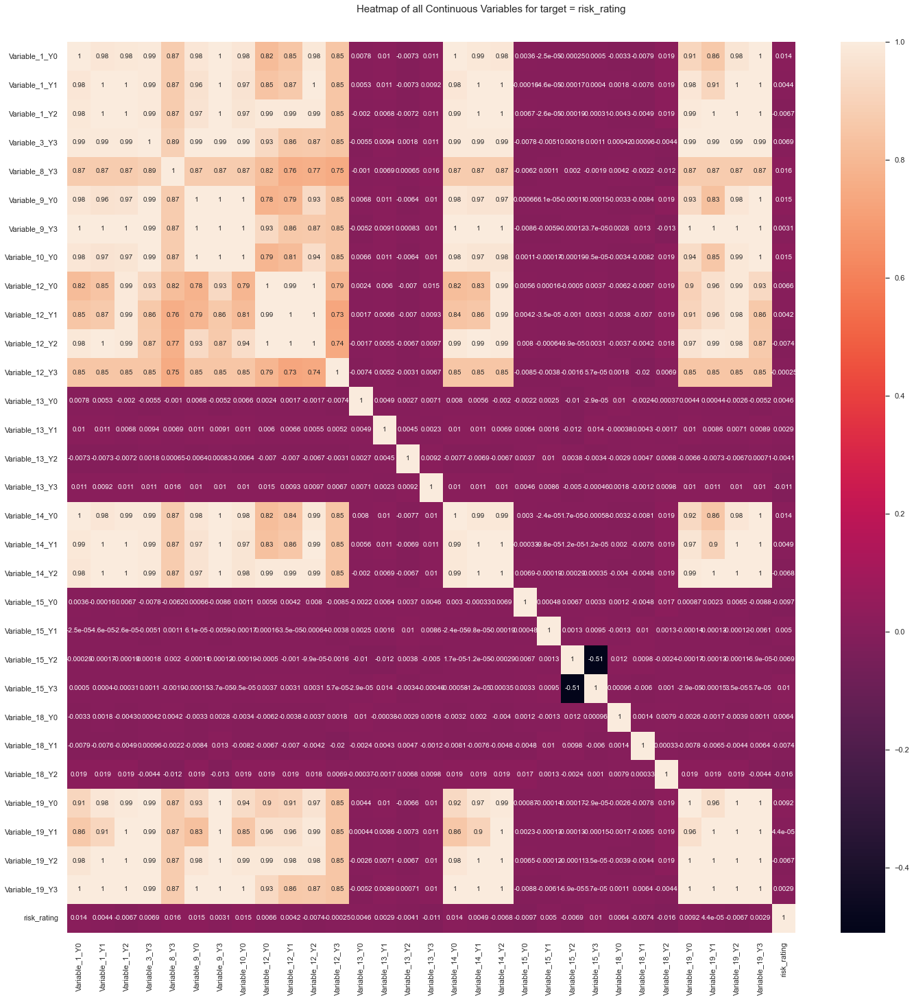

No categorical or boolean vars in data set. Hence no pivot plots...
No categorical or numeric vars in data set. Hence no bar charts.
All Plots done
Time to run AutoViz = 414 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [8]:
# one line code for EDA and more visualization
dft = AV.AutoViz("", dfte=df_client, depVar="risk_rating", verbose=1)


In [9]:
# shuffle the dataframe to split train test datasets
df_shuffled = df_client.sample(frac=1, random_state=0).reset_index().iloc[:,1:]
total_row = df_shuffled.shape[0]
train_row = int(total_row * 0.8)
df_train = df_shuffled.iloc[0:train_row,:]
df_test = df_shuffled.iloc[train_row:,:]

############################################################################################
############       F A S T   F E A T U R E  E N G G    A N D    S E L E C T I O N ! ########
# Be judicious with featurewiz. Don't use it to create too many un-interpretable features! #
############################################################################################
    Shape of your Data Set loaded: (22579, 122)
    Loaded train data. Shape = (22579, 122)
    Some column names had special characters which were removed...
loading the entire test dataframe - there is no nrows limit applicable #########
    Shape of your Data Set loaded: (5645, 122)
    Loaded test data. Shape = (5645, 122)
    Some column names had special characters which were removed...
Classifying features using a random sample of 10000 rows from dataset...
#### Single_Label Multi_Classification problem ####
    loading a random sample of 10000 rows into pandas for EDA
#############################################

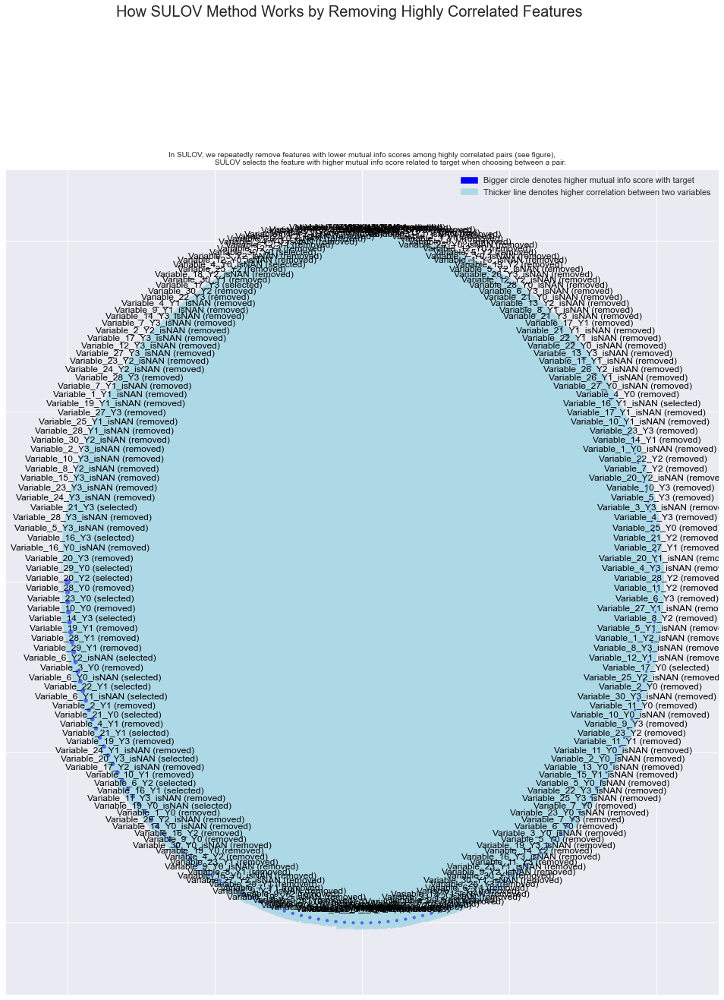

Time taken for SULOV method = 23 seconds
    Adding 1 categorical variables to reduced numeric variables  of 50
Final list of selected vars after SULOV = 51
Readying dataset for Recursive XGBoost by converting all features to numeric...
    there were no mixed data types or object columns that errored. Data is all numeric...
Shape of train data after pruning = (22579, 241)
    Shape of test data after pruning = (5645, 241)
#######################################################################################
#####    R E C U R S I V E   X G B O O S T : F E A T U R E   S E L E C T I O N  #######
#######################################################################################
    using regular XGBoost
Since ['target'] category encoding is done, dropping original categorical vars from predictors...
Current number of predictors = 50 
    XGBoost version using 1.6.1 as tree method: hist
Number of booster rounds = 100
        using 50 variables...
            Time taken for regular X

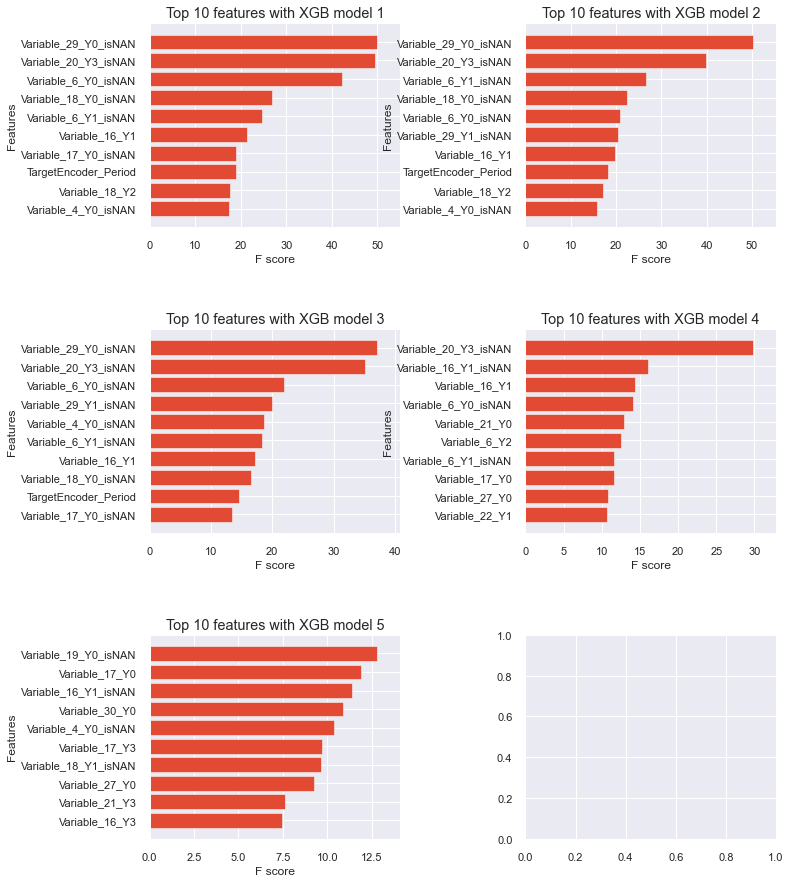

    Completed XGBoost feature selection in 3 seconds
#######################################################################################
#####          F E A T U R E   S E L E C T I O N   C O M P L E T E D            #######
#######################################################################################
Selected 45 important features. Too many to print...
Total Time taken for featurewiz selection = 41 seconds
Output contains two dataframes: train and test with 45 important features.


In [10]:
# one line code for feature selection and engineering, with parameters mostly kept as presets.
outputs = FW.featurewiz(dataname=df_train.drop(columns=["Client", "Self_exclude_flag"]), 
                        target="risk_rating", 
                        corr_limit=0.70, 
                        verbose=2,
                        header=0, 
                        test_data=df_test.drop(columns=["Client", "Self_exclude_flag"]),
                        feature_engg='target',
                        category_encoders=OneHotEncoder,
                        dask_xgboost_flag=False, 
                        nrows=None)

In [11]:
# ignore warnings generated due to redundant parameters by autoviml
def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn

==================== System Information ====================
System: Windows
Node Name: Surface-Laptop-Studio
Release: 10
Version: 10.0.22000
Machine: AMD64
Processor: Intel64 Family 6 Model 140 Stepping 1, GenuineIntel
====================== CPU Information ======================
Physical cores: 4
Total cores: 8
==================== Memory Information ====================
Total: 15.84GB
Available: 8.16GB
Used: 7.68GB
================== System Information End ==================
##############  D A T A   S E T  A N A L Y S I S  #######################
ALERT! Changing hyperparameter search to RS. Otherwise, Random Forests will take too long for 10,000+ rows
Training Set Shape = (22579, 46)
    Training Set Memory Usage = 6.03 MB
Test Set Shape = (5645, 45)
    Test Set Memory Usage = 1.49 MB
Single_Label Target: ['risk_rating']
Random shuffling the data set before training
    Using RandomizedSearchCV for Hyper Parameter Tuning. This is 3X faster than GridSearchCV...
ALERT! Setting Imbal

Time taken = 14 seconds
Based on trying multiple models, Best type of algorithm for this data set is Bagging_Classifier
#############################################################################
    Displaying results of weighted average ensemble of 5 classifiers
Could not plot PR and ROC curves. Continuing...
After multiple models, Ensemble Model Results:
Multi Class Model Metrics Report
#####################################################
    Accuracy          = 23.3%
    Balanced Accuracy (average recall) = 7.3%
    Average Precision (macro) = 8.2%
    Precisions by class:
    0.0%      0.0%      0.0%      37.5%      21.4%      25.1%      22.6%      24.6%      0.0%      0.0%      0.0%      0.0%      0.0%      0.0%      0.0%      0.0%  
    Recall Scores by class:
    0.0%      0.0%      0.0%      0.7%      9.1%      30.1%      66.8%      10.6%      0.0%      0.0%      0.0%      0.0%      0.0%      0.0%      0.0%      0.0%  
    F1 Scores by class:
    0.0%      0.0%      0.0%   

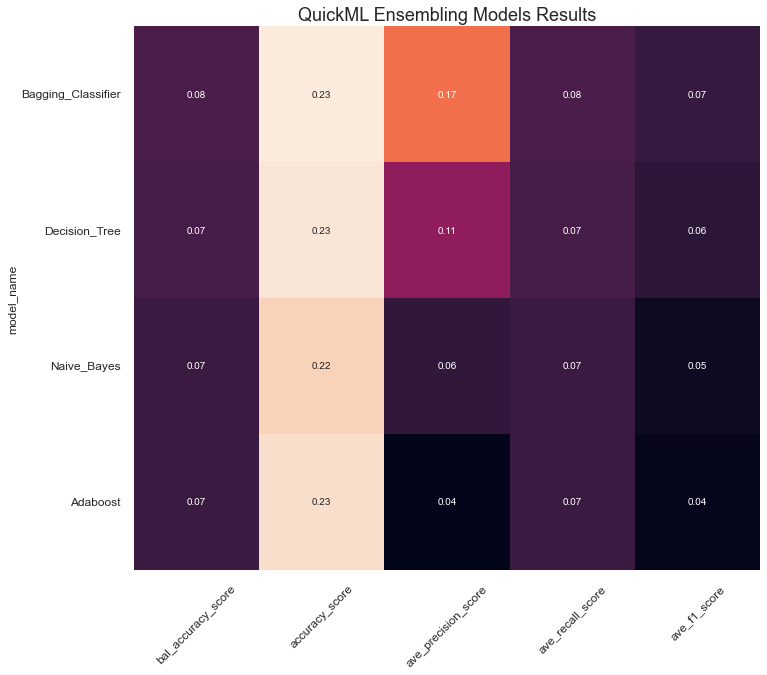

<Figure size 1080x540 with 0 Axes>

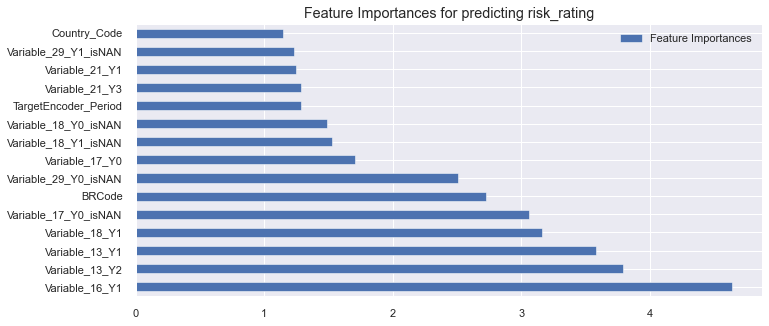

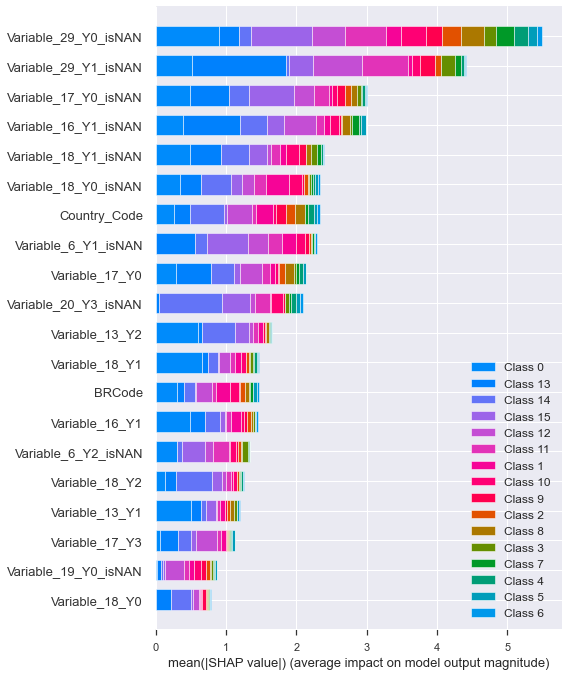

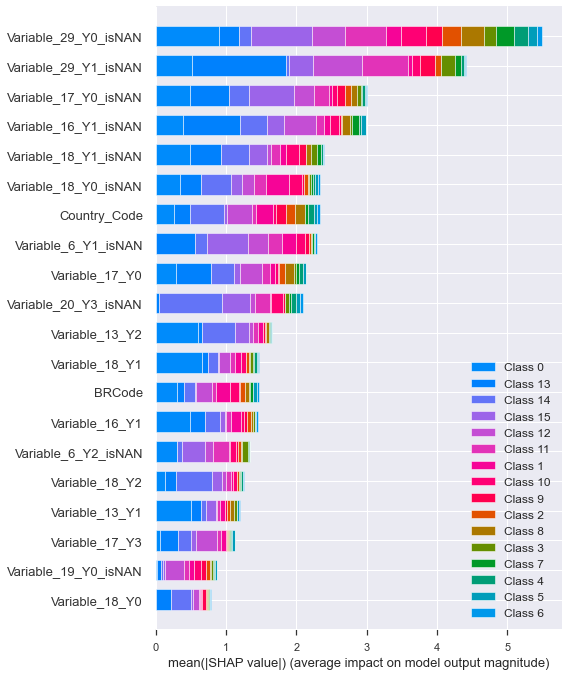

############### P R E D I C T I O N  O N  T E S T   C O M P L E T E D  #################
    Time taken thus far (in seconds) = 626
Writing Output files to disk...
    Saving predictions to .\risk_rating\risk_rating_Multi_Classification_test_modified.csv
    Saving predictions to .\risk_rating\risk_rating_Multi_Classification_submission.csv
    Saving predictions to .\risk_rating\risk_rating_Multi_Classification_train_modified.csv
###############  C O M P L E T E D  ################
Time Taken in mins = 10.5 for the Entire Process


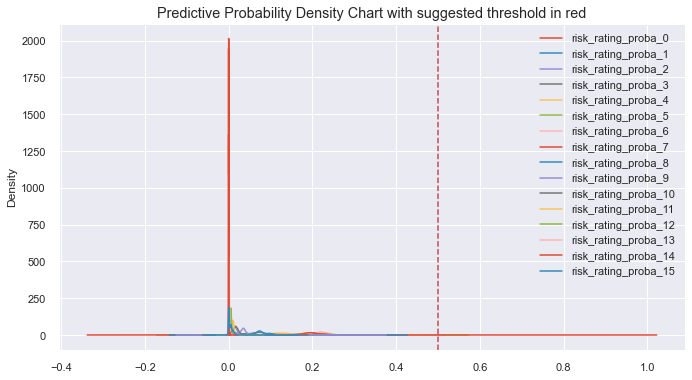

In [12]:
# one liner for model fitting, tuning, and evaluation
model, features, trainm, testm = Auto_ViML(
    outputs[0],
    "risk_rating",
    outputs[1],
    verbose=2,
    scoring_parameter="micro_f1",
    feature_reduction=False
)